In [3]:
import pandas as pd
import torch
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import DataLoader, TensorDataset
from datasets import Dataset, DatasetDict
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, f1_score, recall_score
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from langdetect import detect
import re
# import nltk
# from nltk.tokenize import word_tokenize

/mnt/partition1/machine_learning/Bengali_Sentiment_Analysis_and_Classification/venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
# nltk.download('punkt_tab')
# print(nltk.data.path)

## Ensure GPU usage

In [5]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(f"Using device: {device}")

Using device: cuda


## Load Bengali Sentiment Dataset

In [6]:
df = pd.read_csv("/mnt/partition1/machine_learning/Bengali_Sentiment_Analysis_and_Classification/dataset.csv")
df.head()

,Rating,Review,Product Name,Product Category,Emotion,Data Source,Sentiment
0,5.0,অসাধারণ ফোন।অনেক পছন্দ হয়েছে।একদম অথেনটিক শাও...,Redmi 12C (4/128GB),Smart Phones,Happy,Daraz,Positive
1,5.0,"Phone is good according to my uses, Upgraded f...",Redmi 12C (4/128GB),Smart Phones,Happy,Daraz,Positive
2,5.0,অল্প দামে দারুন একটা স্মার্টফোন 💙,Redmi 12C (4/128GB),Smart Phones,Love,Daraz,Positive
3,5.0,"Super Fast Delivery ,11200 TK te pailam",Redmi 12C (4/128GB),Smart Phones,Happy,Daraz,Positive
4,5.0,Delay Delivery... Good Product.,Redmi 12C (4/128GB),Smart Phones,Happy,Daraz,Positive


## Select relevant columns

In [7]:
df = df[["Review", "Sentiment", "Emotion"]]
df.columns = ["text", "sentiment", "emotion"]
df.head()

,text,sentiment,emotion
0,অসাধারণ ফোন।অনেক পছন্দ হয়েছে।একদম অথেনটিক শাও...,Positive,Happy
1,"Phone is good according to my uses, Upgraded f...",Positive,Happy
2,অল্প দামে দারুন একটা স্মার্টফোন 💙,Positive,Love
3,"Super Fast Delivery ,11200 TK te pailam",Positive,Happy
4,Delay Delivery... Good Product.,Positive,Happy


## Convert labels to numeric values (0: Negative, 1: Positive) (0:Happy, 1:Love, 2:Sadness, 3:Fear, 4:Anger)

In [8]:
sentiment_encoder = LabelEncoder()
emotion_encoder = LabelEncoder()

df["sentiment"] = sentiment_encoder.fit_transform(df["sentiment"])
df["emotion"] = emotion_encoder.fit_transform(df["emotion"])

df.head(100)

,text,sentiment,emotion
0,অসাধারণ ফোন।অনেক পছন্দ হয়েছে।একদম অথেনটিক শাও...,1,2
1,"Phone is good according to my uses, Upgraded f...",1,2
2,অল্প দামে দারুন একটা স্মার্টফোন 💙,1,3
3,"Super Fast Delivery ,11200 TK te pailam",1,2
4,Delay Delivery... Good Product.,1,2
...,...,...,...
95,alhamdulillah good products \nthanks you daraz,1,3
96,কেনার আগে দেখে আসুন ভিডিও।। সাচ করুন PRB786 লি...,0,1
97,Nice Product....,1,2
98,I've never thought that Daraz is serving the g...,1,3


## Preprocessing Mixed-Language Text

In [9]:
def preprocess_text(text):
    print(f"Before process : {text}")
    text = str(text).lower()  # Convert to lowercase
    text = re.sub(r"[\d]+", "", text)  # Remove numbers
    text = re.sub(r"[^\w\sঀ-৿.,!?₹$]", "", text)  # Keep Bengali and English letters
    # tokens = word_tokenize(text)  # Tokenize using NLTK
    # tokenized_text = " ".join(tokens)  # Convert tokens back to string
    print(f"after process : {text}")
    return text

def detect_language(text):
    try:
        return detect(text)
    except:
        return "unknown"

df["text"] = df["text"].apply(preprocess_text)
# df["language"] = df["text"].apply(detect_language)
df.head()

Before process : অসাধারণ ফোন।অনেক পছন্দ হয়েছে।একদম অথেনটিক শাওমি ফোন খুব সুন্দর ভাবে প্যাকেট করা ছিল।48 ঘণ্টায় ডেলিভারি পেয়েছি।রাইডার ভাই অনেক ভালো ছিল তার ব্যবহারে আমি মুগ্ধ।
একটা খারাপ লাগা দিক হলো মোবাইলের সাথে কোনো কভার বা গ্লাস প্রটেক্টর দেয় নাই শাওমি।এছাড়া সব কিছু ভালো ১০/১০ পণ্য। ❤️❤️❤️❤️
after process : অসাধারণ ফোনঅনেক পছন্দ হয়েছেএকদম অথেনটিক শাওমি ফোন খুব সুন্দর ভাবে প্যাকেট করা ছিল ঘণ্টায় ডেলিভারি পেয়েছিরাইডার ভাই অনেক ভালো ছিল তার ব্যবহারে আমি মুগ্ধ
একটা খারাপ লাগা দিক হলো মোবাইলের সাথে কোনো কভার বা গ্লাস প্রটেক্টর দেয় নাই শাওমিএছাড়া সব কিছু ভালো  পণ্য 
Before process : Phone is good according to my uses, Upgraded from Realme C11 2020, Except camera it's a good bump. 
Got a faster delivery within 12 hrs.
after process : phone is good according to my uses, upgraded from realme c , except camera its a good bump. 
got a faster delivery within  hrs.
Before process : অল্প দামে দারুন একটা স্মার্টফোন 💙
after process : অল্প দামে দারুন একটা স্মার্টফোন 
Before process : Supe

,text,sentiment,emotion
0,অসাধারণ ফোনঅনেক পছন্দ হয়েছেএকদম অথেনটিক শাওমি...,1,2
1,"phone is good according to my uses, upgraded f...",1,2
2,অল্প দামে দারুন একটা স্মার্টফোন,1,3
3,"super fast delivery , tk te pailam",1,2
4,delay delivery... good product.,1,2


## Split Data into Train & Test Sets

In [10]:
train_texts, test_texts, train_sentiments, test_sentiments, train_emotions, test_emotions = train_test_split(
    df["text"], df["sentiment"], df["emotion"], test_size=0.2, random_state=42
)

## Create train and test dataset

In [11]:
train_dataset = Dataset.from_dict({"text": train_texts.tolist(), "sentiment": train_sentiments.tolist(), "emotion": train_emotions.tolist()})
test_dataset = Dataset.from_dict({"text": test_texts.tolist(), "sentiment": test_sentiments.tolist(), "emotion": test_emotions.tolist()})

datasets = DatasetDict({"train": train_dataset, "test": test_dataset})

## Define the model to have two output heads: Sentiment and Emotion

In [12]:
class MultiTaskModel(torch.nn.Module):
    def __init__(self, model_name):
        super(MultiTaskModel, self).__init__()
        self.model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=2, output_hidden_states=True)  # Enable hidden states output
        self.sentiment_head = torch.nn.Linear(self.model.config.hidden_size, 2)  # Sentiment output head
        self.emotion_head = torch.nn.Linear(self.model.config.hidden_size, len(df['emotion'].unique()))  # Emotion output head

    def forward(self, input_ids, attention_mask):
        # Pass the input through the transformer model
        outputs = self.model(input_ids, attention_mask=attention_mask)  # This gives logits and hidden states
        
        # Extract hidden states (the last hidden state of the model)
        hidden_states = outputs.hidden_states[-1]  # The last hidden state
        
        # Extract the first token representation (CLS token)
        cls_hidden_state = hidden_states[:, 0, :]  # Shape: (batch_size, hidden_size)
        
        # Get sentiment and emotion logits from the heads
        sentiment_logits = self.sentiment_head(cls_hidden_state)
        emotion_logits = self.emotion_head(cls_hidden_state)
        
        return sentiment_logits, emotion_logits


## Tokenizer, dataloader, trian and evaluation function

In [13]:
# Tokenizing the dataset 
def tokenize_data(texts, tokenizer):
    return tokenizer(texts, padding=True, truncation=True, return_tensors='pt', max_length=128)

# Dataloader creation for both models
def create_dataloader(encodings, sentiment_labels, emotion_labels, batch_size=16):
    dataset = TensorDataset(encodings['input_ids'], encodings['attention_mask'], sentiment_labels, emotion_labels)
    return DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Training function
def train_model(model, dataloader, optimizer, epochs=3):
    epoch_losses = []
    for epoch in range(epochs):
        running_loss = 0.0
        model.train()
        for batch in dataloader:
            optimizer.zero_grad()

            input_ids = batch[0].to(device)
            attention_mask = batch[1].to(device)
            sentiment_labels = batch[2].to(device)
            emotion_labels = batch[3].to(device)
            # print(input_ids,' ',attention_mask,' ',sentiment_labels,' ',emotion_labels,'\n')

            # Forward pass
            sentiment_logits, emotion_logits = model(input_ids, attention_mask)
            loss_sentiment = torch.nn.CrossEntropyLoss()(sentiment_logits, sentiment_labels)
            loss_emotion = torch.nn.CrossEntropyLoss()(emotion_logits, emotion_labels)

            # Total loss is the sum of both tasks' losses
            loss = loss_sentiment + loss_emotion

            # Backward pass and optimization
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

        # average loss in one epoch
        epoch_loss = running_loss / len(dataloader)
        epoch_losses.append(epoch_loss)
        print(f"Epoch {epoch + 1}/{epochs}, Loss: {epoch_loss:.4f}")
    
    # Plot the loss curve
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, epochs + 1), epoch_losses, marker='o', linestyle='-', color='b')
    plt.title('Loss Curve')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.xticks(range(1, epochs + 1))
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Evaluation function
def evaluate_model(model, dataloader):
    model.eval()
    true_sentiments = []
    pred_sentiments = []
    true_emotions = []
    pred_emotions = []
    
    with torch.no_grad():
        for batch in dataloader:
            input_ids = batch[0].to(device)
            attention_mask = batch[1].to(device)
            sentiment_labels = batch[2].to(device)
            emotion_labels = batch[3].to(device)
            
            sentiment_logits, emotion_logits = model(input_ids, attention_mask)
            sentiment_preds = torch.argmax(sentiment_logits, dim=1)
            emotion_preds = torch.argmax(emotion_logits, dim=1)

            # Collect true labels and predictions for both tasks
            true_sentiments.extend(sentiment_labels.cpu().numpy())
            pred_sentiments.extend(sentiment_preds.cpu().numpy())
            true_emotions.extend(emotion_labels.cpu().numpy())
            pred_emotions.extend(emotion_preds.cpu().numpy())

        return np.array(true_sentiments), np.array(pred_sentiments), np.array(true_emotions), np.array(pred_emotions)

        
# Convert labels to tensors and move them to GPU
train_sentiments_tensor = torch.tensor(train_sentiments.values).to(device)
test_sentiments_tensor = torch.tensor(test_sentiments.values).to(device)

train_emotions_tensor = torch.tensor(train_emotions.values).to(device)
test_emotions_tensor = torch.tensor(test_emotions.values).to(device)

## Load and Train mBERT

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-multilingual-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch 1/3, Loss: 0.9549
Epoch 2/3, Loss: 0.8446
Epoch 3/3, Loss: 0.7857


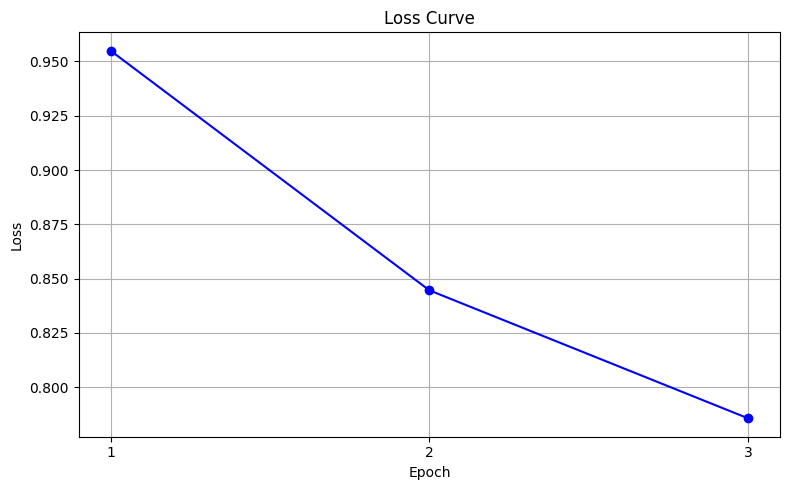

In [14]:
mbert_tokenizer = AutoTokenizer.from_pretrained('bert-base-multilingual-uncased')
mbert_model = MultiTaskModel('bert-base-multilingual-uncased').to(device)

# Tokenize the data
train_encodings_mbert = tokenize_data(train_texts.tolist(), mbert_tokenizer)
test_encodings_mbert = tokenize_data(test_texts.tolist(), mbert_tokenizer)

train_dataloader_mbert = create_dataloader(train_encodings_mbert, train_sentiments_tensor, train_emotions_tensor)
test_dataloader_mbert = create_dataloader(test_encodings_mbert, test_sentiments_tensor, test_emotions_tensor)

# Optimizer
optimizer_mbert = torch.optim.AdamW(mbert_model.parameters(), lr=3e-5)

train_model(mbert_model, train_dataloader_mbert, optimizer_mbert, epochs=3)

# torch.cuda.empty_cache()

## Load and Train XLM-R

Some weights of XLMRobertaForSequenceClassification were not initialized from the model checkpoint at xlm-roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch 1/3, Loss: 1.0306
Epoch 2/3, Loss: 0.8619
Epoch 3/3, Loss: 0.9689


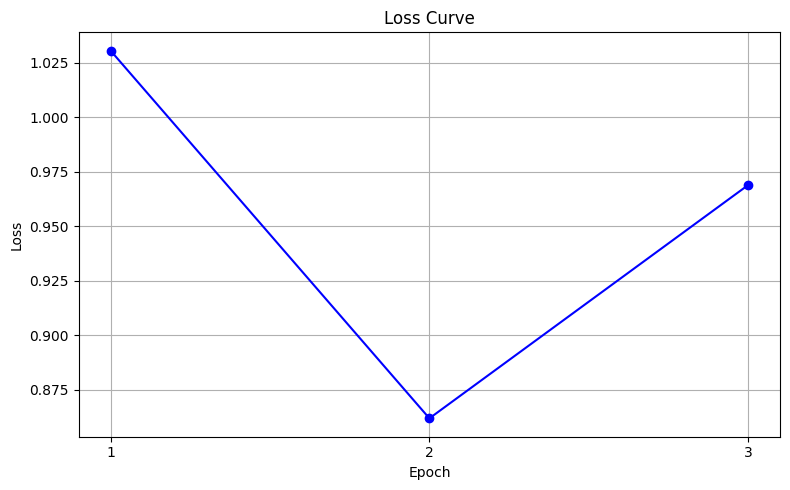

In [15]:
xlmr_tokenizer = AutoTokenizer.from_pretrained('xlm-roberta-base')
xlmr_model = MultiTaskModel('xlm-roberta-base').to(device)

train_encodings_xlmr = tokenize_data(train_texts.tolist(), xlmr_tokenizer)
test_encodings_xlmr = tokenize_data(test_texts.tolist(), xlmr_tokenizer)

train_dataloader_xlmr = create_dataloader(train_encodings_xlmr, train_sentiments_tensor, train_emotions_tensor)
test_dataloader_xlmr = create_dataloader(test_encodings_xlmr, test_sentiments_tensor, test_emotions_tensor)

# Optimizers
optimizer_xlmr = torch.optim.AdamW(xlmr_model.parameters(), lr=3e-5)

train_model(xlmr_model, train_dataloader_xlmr, optimizer_xlmr, epochs=3)

## Get predictions

In [16]:
true_sentiments_mbert, pred_sentiments_mbert, true_emotions_mbert, pred_emotions_mbert = evaluate_model(mbert_model, test_dataloader_mbert)
true_sentiments_xlmr, pred_sentiments_xlmr, true_emotions_xlmr, pred_emotions_xlmr = evaluate_model(xlmr_model, test_dataloader_xlmr)

## Compute metrics

Model: mBERT
Sentiment Accuracy: 0.94, Precision: 0.94, Recall: 0.94, F1: 0.94
Emotion Accuracy: 0.71, Precision: 0.70, Recall: 0.71, F1: 0.69


/mnt/partition1/machine_learning/Bengali_Sentiment_Analysis_and_Classification/venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


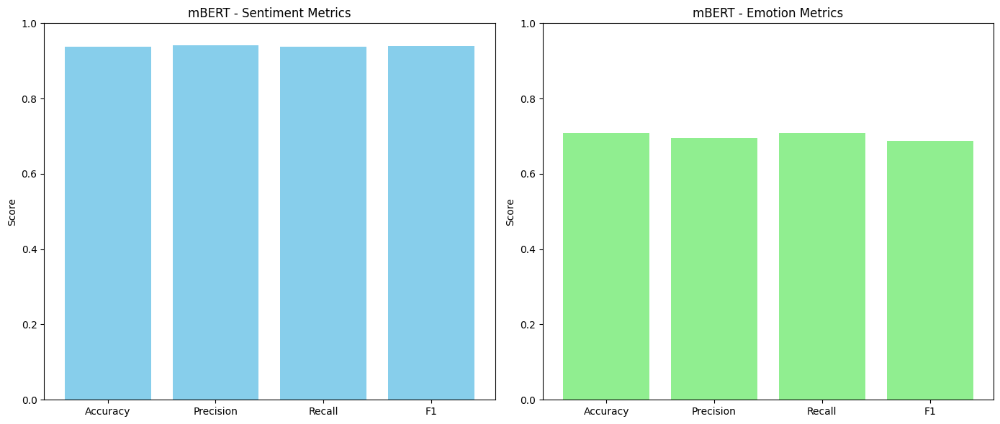

/mnt/partition1/machine_learning/Bengali_Sentiment_Analysis_and_Classification/venv/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Model: XLM-R
Sentiment Accuracy: 0.94, Precision: 0.93, Recall: 0.94, F1: 0.93
Emotion Accuracy: 0.70, Precision: 0.69, Recall: 0.70, F1: 0.67


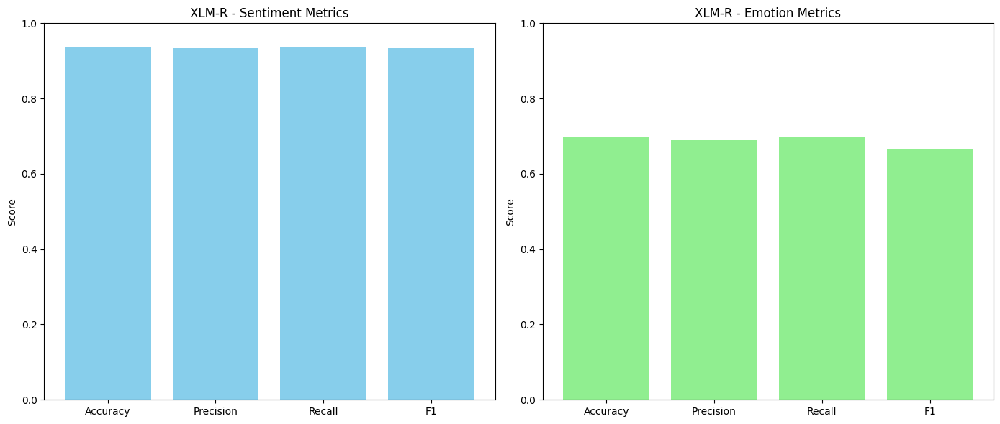

In [17]:
def compute_metrics(true_sentiment, pred_sentiment, true_emotion, pred_emotion, model_name):
    accuracy_sentiment = accuracy_score(true_sentiment, pred_sentiment)
    precision_sentiment = precision_score(true_sentiment, pred_sentiment, average='weighted')
    recall_sentiment = recall_score(true_sentiment, pred_sentiment, average='weighted')
    f1_sentiment = f1_score(true_sentiment, pred_sentiment, average='weighted')
    
    accuracy_emotion = accuracy_score(true_emotion, pred_emotion)
    precision_emotion = precision_score(true_emotion, pred_emotion, average='weighted')
    recall_emotion = recall_score(true_emotion, pred_emotion, average='weighted')
    f1_emotion = f1_score(true_emotion, pred_emotion, average='weighted')

    print(f"Model: {model_name}")
    print(f"Sentiment Accuracy: {accuracy_sentiment:.2f}, Precision: {precision_sentiment:.2f}, Recall: {recall_sentiment:.2f}, F1: {f1_sentiment:.2f}")
    print(f"Emotion Accuracy: {accuracy_emotion:.2f}, Precision: {precision_emotion:.2f}, Recall: {recall_emotion:.2f}, F1: {f1_emotion:.2f}")

    # Plotting the metrics
    labels = ['Accuracy', 'Precision', 'Recall', 'F1']
    
    sentiment_scores = [accuracy_sentiment, precision_sentiment, recall_sentiment, f1_sentiment]
    emotion_scores = [accuracy_emotion, precision_emotion, recall_emotion, f1_emotion]

    # Create subplots for both sentiment and emotion metrics
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    
    # Sentiment metrics plot
    axes[0].bar(labels, sentiment_scores, color='skyblue')
    axes[0].set_title(f'{model_name} - Sentiment Metrics')
    axes[0].set_ylim(0, 1)
    axes[0].set_ylabel('Score')
    
    # Emotion metrics plot
    axes[1].bar(labels, emotion_scores, color='lightgreen')
    axes[1].set_title(f'{model_name} - Emotion Metrics')
    axes[1].set_ylim(0, 1)
    axes[1].set_ylabel('Score')
    
    plt.tight_layout()
    plt.show()

compute_metrics(true_sentiments_mbert, pred_sentiments_mbert, true_emotions_mbert, pred_emotions_mbert, model_name="mBERT")
compute_metrics(true_sentiments_xlmr, pred_sentiments_xlmr, true_emotions_xlmr, pred_emotions_xlmr, model_name="XLM-R")

## Save trained model

In [18]:
# torch.save(mbert_model.state_dict(), "mbert_model.pth")
# torch.save(xlmr_model.state_dict(), "xlmr_model.pth")

# torch.save(optimizer_mbert.state_dict(), "optimizer_mbert.pth")
# torch.save(optimizer_xlmr.state_dict(), "optimizer_xlmr.pth")

# # If you are using learning rate schedulers, you can also save them
# # torch.save(scheduler_mbert.state_dict(), "scheduler_mbert.pth")
# # torch.save(scheduler_xlmr.state_dict(), "scheduler_xlmr.pth")

# # Optionally, save the tokenizer
# mbert_tokenizer.save_pretrained('./mbert_tokenizer')
# xlmr_tokenizer.save_pretrained('./xlmr_tokenizer')

# print("Models, optimizers, and tokenizers saved successfully!")

## Live prediction function

In [19]:
def live_prediction(text):
    preprocessed_text = preprocess_text(text)

    # Tokenize for both models
    mbert_input = mbert_tokenizer(preprocessed_text, return_tensors='pt', padding=True, truncation=True, max_length=128).to(device)
    xlmr_input = xlmr_tokenizer(preprocessed_text, return_tensors='pt', padding=True, truncation=True, max_length=128).to(device)

    # Remove token_type_ids if they exist, because they are not needed in most cases
    mbert_input = {key: value for key, value in mbert_input.items() if key != 'token_type_ids'}
    xlmr_input = {key: value for key, value in xlmr_input.items() if key != 'token_type_ids'}

    # Predict with mBERT
    mbert_model.eval()
    with torch.no_grad():
        mbert_output = mbert_model(**mbert_input)
        mbert_sentiment_pred = torch.argmax(mbert_output[0], dim=1).cpu().numpy()[0]
        mbert_emotion_pred = torch.argmax(mbert_output[1], dim=1).cpu().numpy()[0]

    # Predict with XLM-R
    xlmr_model.eval()
    with torch.no_grad():
        xlmr_output = xlmr_model(**xlmr_input)
        xlmr_sentiment_pred = torch.argmax(xlmr_output[0], dim=1).cpu().numpy()[0]
        xlmr_emotion_pred = torch.argmax(xlmr_output[1], dim=1).cpu().numpy()[0]

    # Sentiment and Emotion Mapping
    sentiment_mapping = {0: "Negative", 1: "Positive"}
    emotion_mapping = {2:"Happy", 3:"Love", 4:"Sadness", 1:"Fear", 0:"Anger"}
    # print(mbert_sentiment_pred, xlmr_sentiment_pred)
    # print(mbert_emotion_pred, xlmr_emotion_pred)
    # print(emotion_mapping)

    return sentiment_mapping[mbert_sentiment_pred], emotion_mapping[mbert_emotion_pred], sentiment_mapping[xlmr_sentiment_pred], emotion_mapping[xlmr_emotion_pred]

# To test the live prediction
while(True):
    user_input = input("Enter a product review for prediction: ")
    if user_input == "b" or user_input == "break":
        break
    mbert_sentiment, mbert_emoition, xlmr_sentiment, xlmr_emotion = live_prediction(user_input)
    print(f"mBERT Prediction: {mbert_sentiment} sentiment, {mbert_emoition} emotion")
    print(f"XLM-R Prediction: {xlmr_sentiment} sentiment, {xlmr_emotion} emotion")
    print('\n')